In [1]:
from dendrocat import RadioSource
from astropy.io import fits
from spectral_cube import SpectralCube
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import numpy as np
import sys
import importlib
from astropy.wcs import WCS
from scipy import interpolate
import pandas as pd
import sympy as syp
from astropy import units as u
import radio_beam
from astropy.table import Table
from radio_beam import Beam
from astropy import coordinates
from astropy import wcs
from astropy.nddata.utils import Cutout2D
from dendrocat.aperture import Ellipse
from regions import Regions, PixCoord
from astropy import stats
from itertools import chain
import matplotlib.cm as cm

W51 = '/orange/adamginsburg/w51/TaehwaYoo/'
W51b6 = '/orange/adamginsburg/w51/TaehwaYoo/2015.1.01596.S_W51_B6_LB/continuum_images/'
W51cont='/orange/adamginsburg/w51/TaehwaYoo/b6contfits/'
w51e2_b6_briggs=W51cont+'W51e2_cont_bigbriggs.image.fits'
w51e2_b6_robust0=W51cont+'W51e2_cont_big_robust0.image.fits'
w51e2_b6_uniform=W51cont+'W51e2_cont_biguniform.image.fits'
w51e2_b6_superuniform=W51cont+'W51e2_cont_bigsuperuniform.image.fits'

w51n_b6_briggs = W51cont+'W51n_cont_bigbriggs.image.fits'
w51n_b6_robust0 = W51cont+'w51n_cont_big_robust0.image.fits'
w51n_b6_uniform = W51cont+'W51n_cont_biguniform.image.fits'
w51n_b6_superuniform = W51cont+'W51n_cont_bigsuperuniform.image.fits'
w51n_b6_natural = W51cont+'W51n_cont_bignatural.image.fits'

W51b3 = '/orange/adamginsburg/w51/TaehwaYoo/2017.1.00293.S_W51_B3_LB/may2021_successful_imaging/'

w51n_b3_tt0 = W51b3+'w51n.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits'
w51n_b3_tt1 = W51+'w51n.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt1.pbcor.fits'
w51n_b3_alpha = W51+'w51n.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.alpha.pbcor.fits'

w51conv = '/orange/adamginsburg/w51/TaehwaYoo/convolved_new/'
w51n_b6_conv = w51conv + 'w51n_cont_bigbriggs.image.convB3_briggs.fits'

w51e_b3_tt0 = W51b3+'w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits'
w51e_b3_tt1 = W51+'w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt1.pbcor.fits'
w51e_b3_alpha = W51+'w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.alpha.pbcor.fits'

w51e2_b6_conv = w51conv + 'w51e2_cont_bigbriggs.image.convB3_briggs.fits'

w51e_b6_almaimf_conv = '/orange/adamginsburg/w51/TaehwaYoo/w51_alma_imf/w51e_B6_conv.fits'
w51e_b3_almaimf_conv = '/orange/adamginsburg/w51/TaehwaYoo/w51_alma_imf/w51e_B3_conv.fits'


w51n_b3_almaimf_conv = '/orange/adamginsburg/w51/TaehwaYoo/w51_alma_imf/w51n_B3_conv.fits'

w51n_b6_almaimf = '/orange/adamginsburg/w51/TaehwaYoo/w51_alma_imf/W51-IRS2_B6_uid___A001_X1296_X187_continuum_merged_12M_robust0_selfcal9_finaliter.image.tt0.pbcor.fits'

w51n_b6_conv = w51conv + 'w51n_B6_conv.fits'
#w51n_b3_conv = w51conv + 'w51n_B3_conv.fits'
#w51e_b3_conv = w51conv + 'w51e_B3_conv.fits'
w51e_b6_conv = w51conv + 'w51e_B6_conv.fits'


w51e_matched_catalog = '/home/t.yoo/w51/catalogue/dendrogram/dendro_w51e_matched.fits'
w51n_matched_catalog = '/home/t.yoo/w51/catalogue/dendrogram/dendro_w51n_matched.fits'

w51e_b3_noiseregion = '/orange/adamginsburg/w51/TaehwaYoo/w51e_b3_std_sky.reg'
w51e_b6_noiseregion = '/orange/adamginsburg/w51/TaehwaYoo/w51e_b6_std_sky.reg'
w51n_b3_noiseregion = '/orange/adamginsburg/w51/TaehwaYoo/w51n_b3_std_sky.reg'
w51n_b6_noiseregion = '/orange/adamginsburg/w51/TaehwaYoo/w51n_b6_std_sky.reg'





(14500, 14500)
       temp       
------------------
 20.38982221533678
28.426876314251658
 9.504874933373566
26.938573804688243
52.482014765764916
14.390547838517614
 7.464450016626431
                --
  63.9576246938646
                --
               ...
                --
                --
                --
                --
                --
                --
                --
                --
                --
                --
                --
Length = 137 rows


(5000.0, 8500.0)

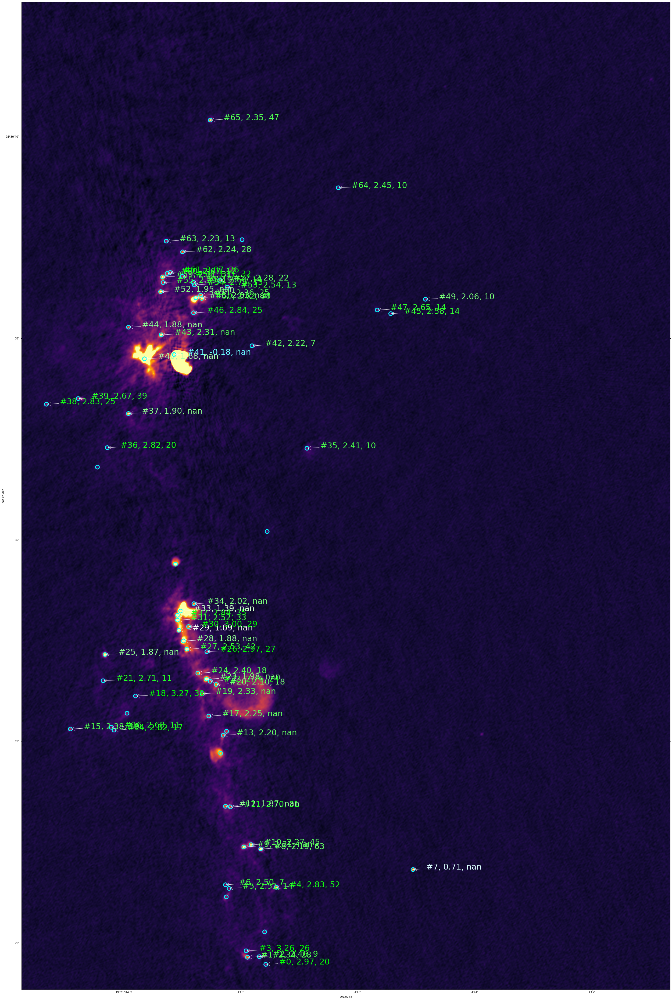

In [2]:
import matplotlib as mpl

fitsdata_b3 = fits.open(w51e_b3_tt0)
imageb3 = fitsdata_b3[0].data
if len(imageb3.shape)!=2:
    imageb3 = imageb3[0][0]
print(imageb3.shape)
hdrNB3 = fits.getheader(w51e_b3_tt0)  
wcsNB3 = WCS(hdrNB3,naxis=2)
scaleNB3 = wcsNB3.proj_plane_pixel_scales()[0]
fig = plt.figure(figsize=(60,60))
ax1 = fig.add_axes([0.15,0.15,0.85,0.85],projection=wcsNB3)
imageb3 = fitsdata_b3[0].data[0][0]
ax1.imshow(imageb3, origin='lower',cmap=plt.get_cmap('inferno'),vmin=-0.00010907209521789237,vmax=0.0010342193801073328)

w51e_cat = Table.read(w51e_matched_catalog)
xpos = w51e_cat['b3_xpix']
ypos = w51e_cat['b3_ypix']
si = w51e_cat['alpha']
ismatched = w51e_cat['is_matched']
temp = w51e_cat['temp']
print(temp)
no =np.where(ismatched)[0]
cmap = cm.YlGn
cmap = mpl.colors.LinearSegmentedColormap.from_list("", ['cyan',"w","lime"])
norm = mpl.colors.Normalize(vmin=-1, vmax=3)
    
ax1.scatter(xpos,ypos, edgecolor='cyan',  c='none',cmap=cmap,norm=norm,s=200, lw=3)
xtextpos = np.ones(len(np.where(ismatched)[0]))*50
ytextpos = np.ones(len(np.where(ismatched)[0]))*0
m = cm.ScalarMappable(norm=norm, cmap=cmap)

for i in range(len(np.where(ismatched)[0])):
    if np.isfinite(temp[i]):
        ss=ax1.annotate("#%d, %3.2f, %d"%(no[i],si[ismatched][i],temp[i]),xy=(xpos[ismatched][i],ypos[ismatched][i]), xycoords='data', textcoords='offset pixels',
                        arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(si[ismatched][i]))
    else:
        ss=ax1.annotate("#%d, %3.2f, nan"%(no[i],si[ismatched][i]),xy=(xpos[ismatched][i],ypos[ismatched][i]), xycoords='data', textcoords='offset pixels',
                        arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(si[ismatched][i]))
ax1.set_xlim(6700,9000)
ax1.set_ylim(5000,8500)


(14500, 14500)


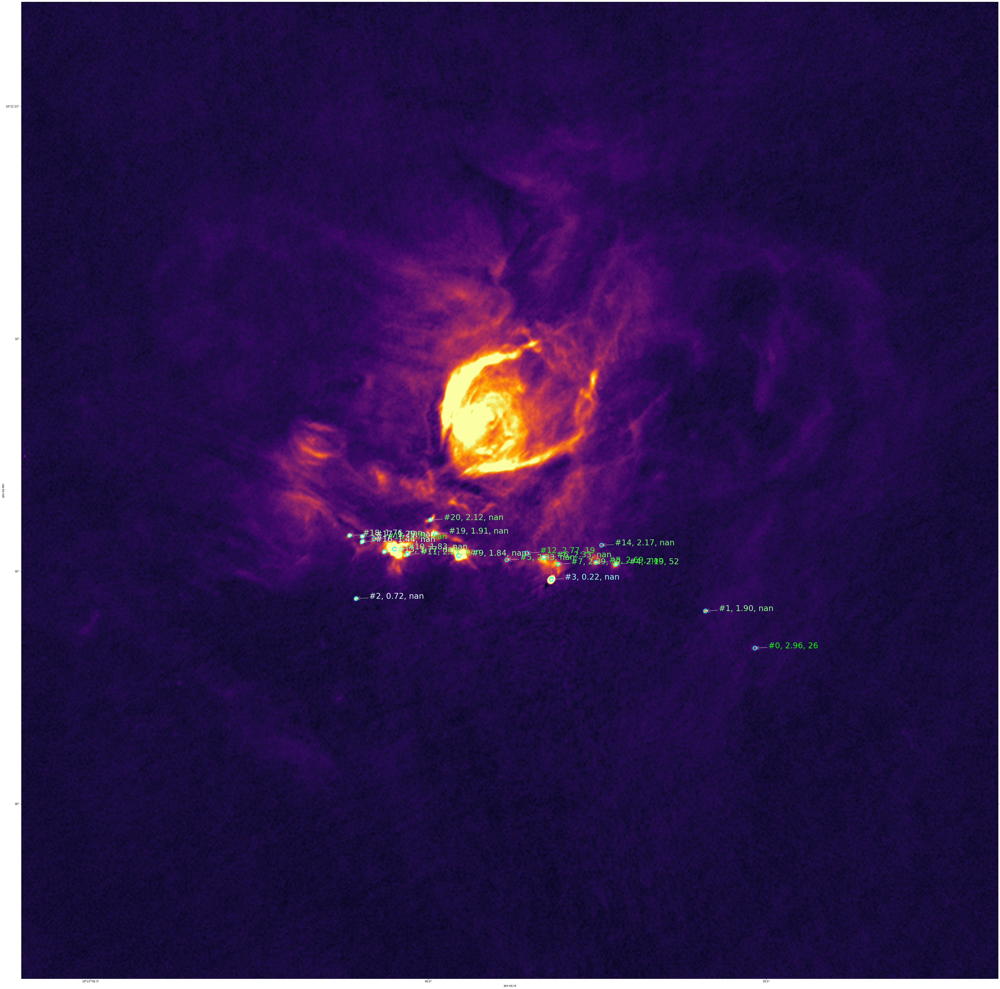

In [3]:
fitsdata_b3 = fits.open(w51n_b3_tt0)
imageb3 = fitsdata_b3[0].data
if len(imageb3.shape)!=2:
    imageb3 = imageb3[0][0]
print(imageb3.shape)
hdrNB3 = fits.getheader(w51n_b3_tt0)  
wcsNB3 = WCS(hdrNB3,naxis=2)
scaleNB3 = wcsNB3.proj_plane_pixel_scales()[0]
fig = plt.figure(figsize=(60,60))
ax1 = fig.add_axes([0.15,0.15,0.85,0.85],projection=wcsNB3)
imageb3 = fitsdata_b3[0].data[0][0]
ax1.imshow(imageb3, origin='lower',cmap=plt.get_cmap('inferno'),vmin=-0.00010907209521789237,vmax=0.0010342193801073328)

w51n_cat = Table.read(w51n_matched_catalog)
xpos = w51n_cat['b3_xpix']
ypos = w51n_cat['b3_ypix']
si = w51n_cat['alpha']
ismatched = w51n_cat['is_matched']
temp = w51n_cat['temp']

cmap = cm.YlGn
cmap = mpl.colors.LinearSegmentedColormap.from_list("", ['cyan',"w","lime"])
norm = mpl.colors.Normalize(vmin=-1, vmax=3)
    
ax1.scatter(xpos[ismatched],ypos[ismatched], edgecolor='cyan',  c='none',cmap=cmap,norm=norm,s=200, lw=3)
xtextpos = np.ones(len(np.where(ismatched)[0]))*50
ytextpos = np.ones(len(np.where(ismatched)[0]))*0
m = cm.ScalarMappable(norm=norm, cmap=cmap)
ax1.set_xlim(6000,9000)
ax1.set_ylim(6000,9000)
for i in range(len(np.where(ismatched)[0])):
    if np.isfinite(temp[i]):
        ss=ax1.annotate("#%d, %3.2f, %d"%(no[i],si[ismatched][i],temp[i]),xy=(xpos[ismatched][i],ypos[ismatched][i]), xycoords='data', textcoords='offset pixels',
                        arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(si[ismatched][i]))
    else:
        ss=ax1.annotate("#%d, %3.2f, nan"%(no[i],si[ismatched][i]),xy=(xpos[ismatched][i],ypos[ismatched][i]), xycoords='data', textcoords='offset pixels',
                        arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(si[ismatched][i]))
plt.savefig('w51n_alpha_map.png')    

(14500, 14500)


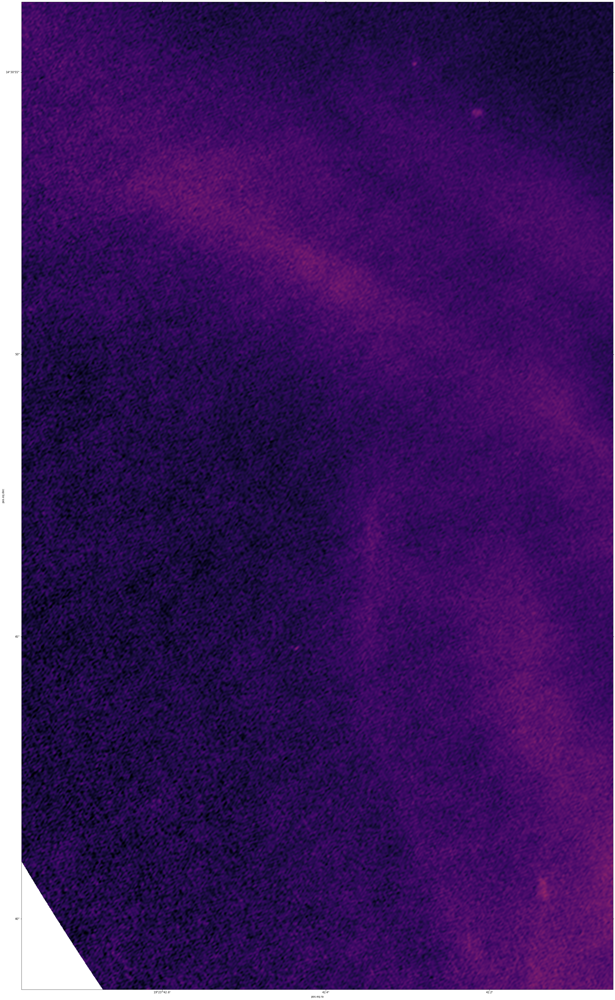

In [4]:
fitsdata_b3 = fits.open(w51n_b3_tt0)
imageb3 = fitsdata_b3[0].data
if len(imageb3.shape)!=2:
    imageb3 = imageb3[0][0]
print(imageb3.shape)
hdrNB3 = fits.getheader(w51n_b3_tt0)  
wcsNB3 = WCS(hdrNB3,naxis=2)
scaleNB3 = wcsNB3.proj_plane_pixel_scales()[0]
fig = plt.figure(figsize=(60,60))
ax1 = fig.add_axes([0.15,0.15,0.85,0.85],projection=wcsNB3)
imageb3 = fitsdata_b3[0].data[0][0]
ax1.imshow(imageb3, origin='lower',cmap=plt.get_cmap('inferno'),vmin=-0.00010907209521789237,vmax=0.0010342193801073328)

w51n_cat = Table.read(w51n_matched_catalog)
xpos = w51n_cat['b3_xpix']
ypos = w51n_cat['b3_ypix']
si = w51n_cat['alpha']
ismatched = w51n_cat['is_matched']
temp = w51n_cat['temp']

cmap = cm.YlGn
cmap = mpl.colors.LinearSegmentedColormap.from_list("", ['cyan',"w","lime"])
norm = mpl.colors.Normalize(vmin=-1, vmax=3)
    
ax1.scatter(xpos[ismatched],ypos[ismatched], edgecolor='cyan',  c='none',cmap=cmap,norm=norm,s=200, lw=3)
xtextpos = np.ones(len(np.where(ismatched)[0]))*50
ytextpos = np.ones(len(np.where(ismatched)[0]))*0
m = cm.ScalarMappable(norm=norm, cmap=cmap)
ax1.set_xlim(1500,3000)
ax1.set_ylim(3500,6000)
for i in range(len(np.where(ismatched)[0])):
    if np.isfinite(temp[i]):
        ss=ax1.annotate("#%d, %3.2f, %d"%(no[i],si[ismatched][i],temp[i]),xy=(xpos[ismatched][i],ypos[ismatched][i]), xycoords='data', textcoords='offset pixels',
                        arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(si[ismatched][i]))
    else:
        ss=ax1.annotate("#%d, %3.2f, nan"%(no[i],si[ismatched][i]),xy=(xpos[ismatched][i],ypos[ismatched][i]), xycoords='data', textcoords='offset pixels',
                        arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(si[ismatched][i]))
    